##### Further Improvements - Add scale bars, change color scheme

In [1]:
import scanpy as sc
import os
import numpy as np
import pandas as pd

In [2]:
output_folder = r'../../outputs'

In [3]:
ad_sp = sc.read(os.path.join(output_folder,'adatas', 'combined_spatial_seurat.h5ad'))

In [4]:
figure_output_folder = './'

In [5]:
sc.set_figure_params(dpi=300, dpi_save=400)

### Prepare to generate figure

In [6]:
unique_batches = np.unique(ad_sp.obs.batch.values)
new_batch_names = pd.DataFrame(zip(unique_batches, ['4hr', '6hr', '9hr', '24hr', 'mock']))
n_batches = []
for i in ad_sp.obs.batch.values:
    n_batches.append(new_batch_names[1].values[new_batch_names[0] == i][0])
ad_sp.obs['batch'] = n_batches
unique_batches = np.unique(ad_sp.obs.batch.values)

### Figure 5f

In [7]:
try:
    os.mkdir(os.path.join(figure_output_folder, '5f'))
except:
    print('Folder already exists')

/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: Us

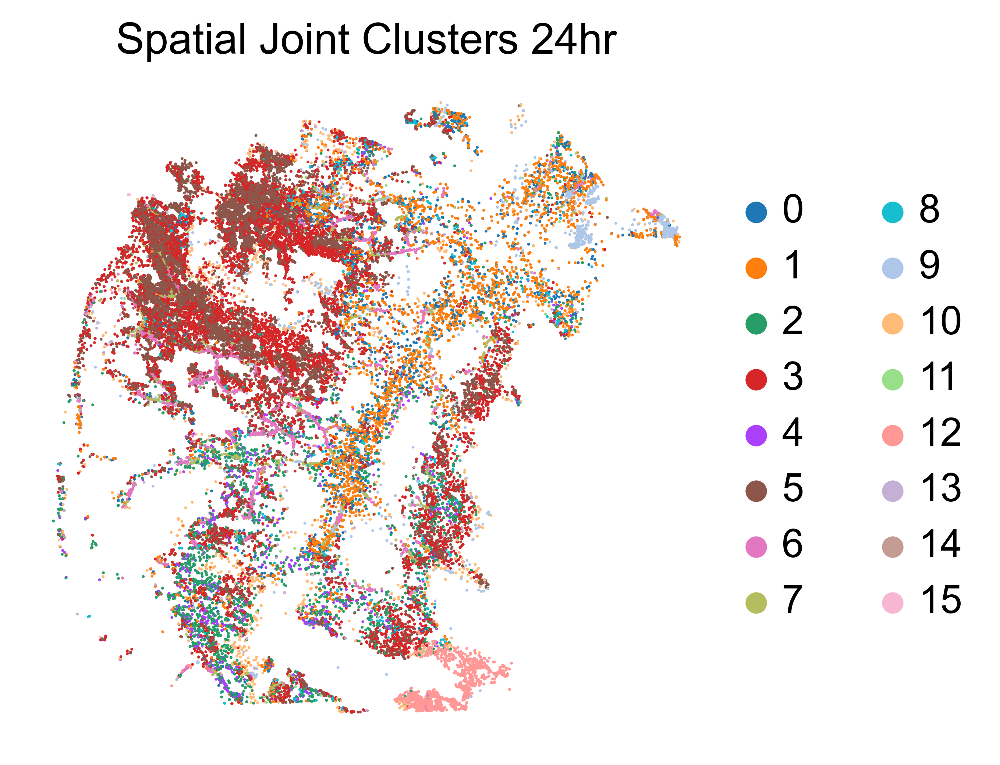

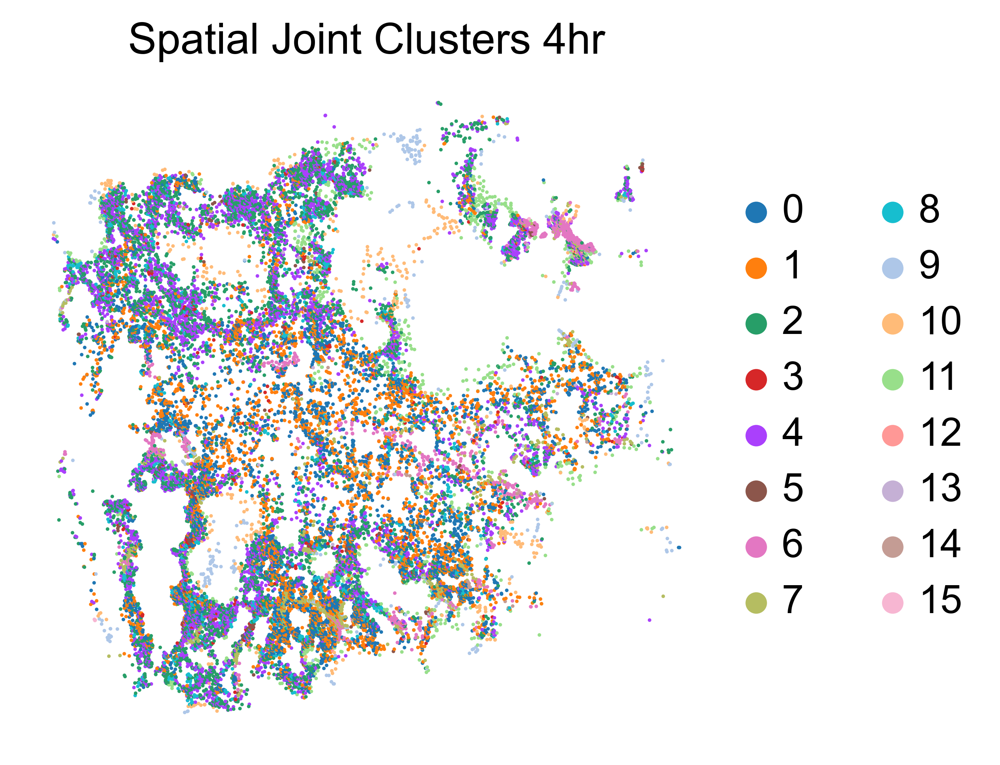

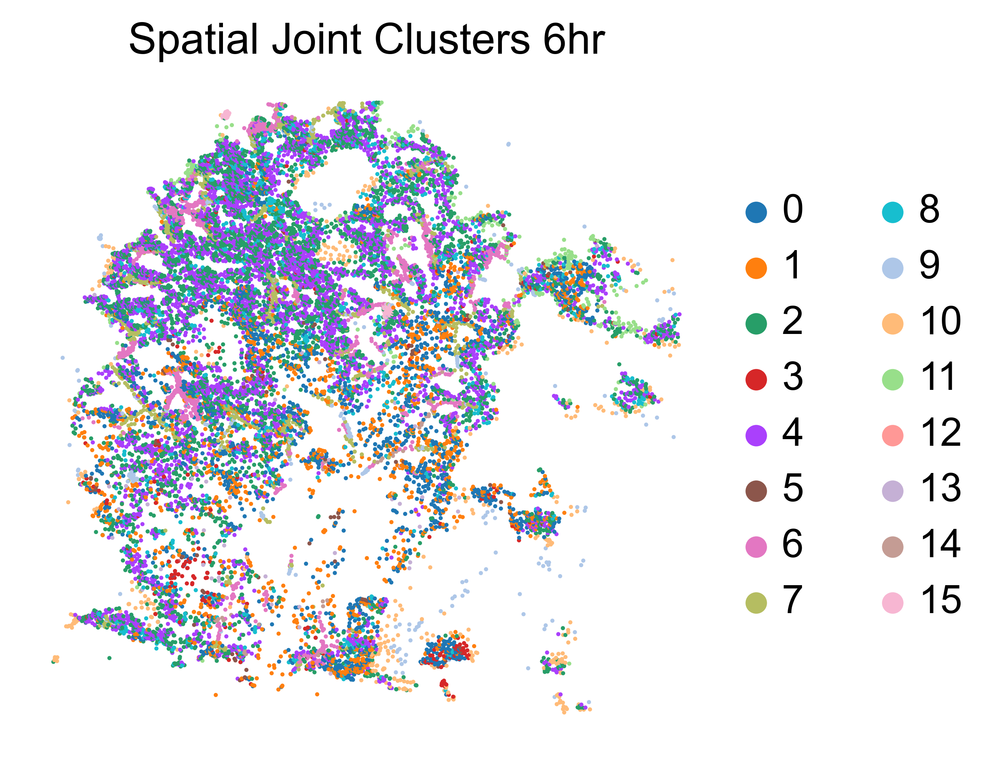

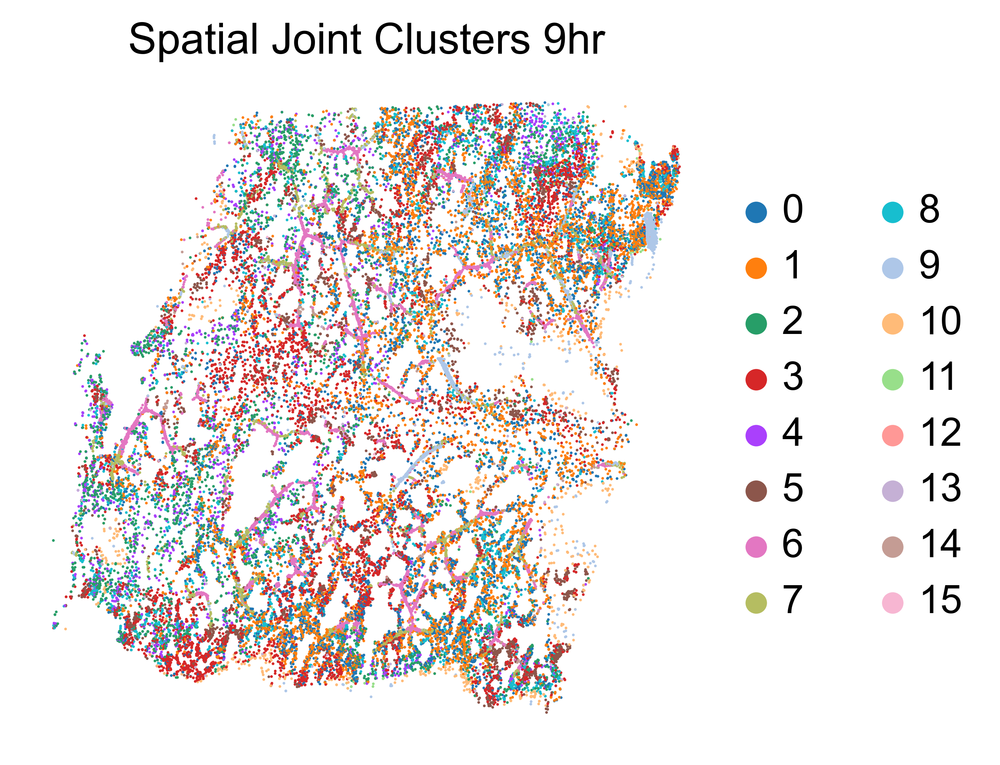

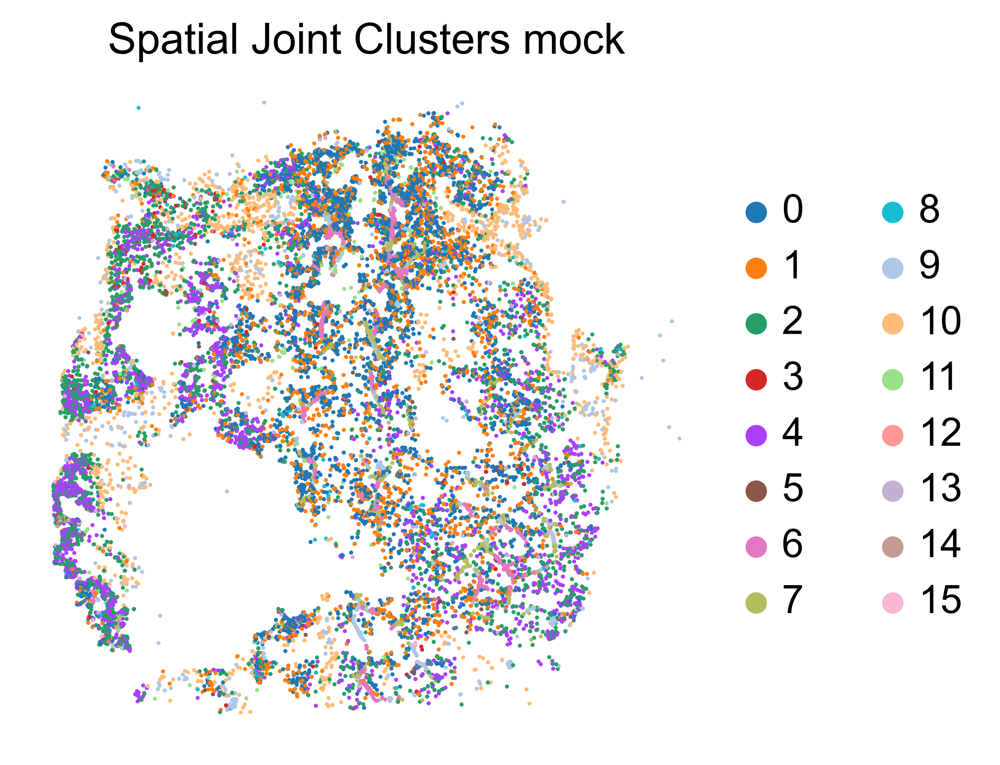

In [8]:
import matplotlib.pyplot as plt
for i in range(len(unique_batches)):
    batch = unique_batches[i]
    adata = ad_sp[ad_sp.obs.batch == batch]
    adata.obsm['X_spatial'] = adata.obs[['x', 'y']].values
    sc.pl.embedding(adata, basis='spatial', color=['seurat_clusters'], vmax=0.1, frameon=False, title=f'Spatial Joint Clusters {batch}', return_fig=True)
    unique_clusters = adata.obs.seurat_clusters.cat.categories

    try:
        os.mkdir(os.path.join(figure_output_folder, '5f', batch))
    except:
        print('Folder already exists')

    ct = 0 
    for uni in unique_clusters:
        where_cluster = np.array(adata.obs['seurat_clusters'] == uni).astype(int)
        color_ = adata.uns['seurat_clusters_colors'][ct]
        color_array = np.array([color_ if i == 1 else '#d3d3d3' for i in where_cluster])

        where_zero = np.where(where_cluster== 0)[0]
        plt.figure(dpi=300)
        plt.scatter(adata.obsm['X_spatial'][where_zero, 0], adata.obsm['X_spatial'][where_zero, 1], c=color_array[where_zero], s=1)
        where_one = np.where(where_cluster== 1)[0]
        plt.scatter(adata.obsm['X_spatial'][where_one, 0], adata.obsm['X_spatial'][where_one, 1], c=color_array[where_one], s=1)
        plt.title('Cluster ' + uni + ' ' + batch)
        plt.grid(False)
        plt.savefig(os.path.join(figure_output_folder, '5f', batch, uni+'.pdf'))
        plt.close()
        ct += 1
    
    #fig.tight_layout()
    #fig.savefig(os.path.join(figure_output_folder, '5f', f'Spatial Joint Clusters {batch}.pdf'))

/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: Us

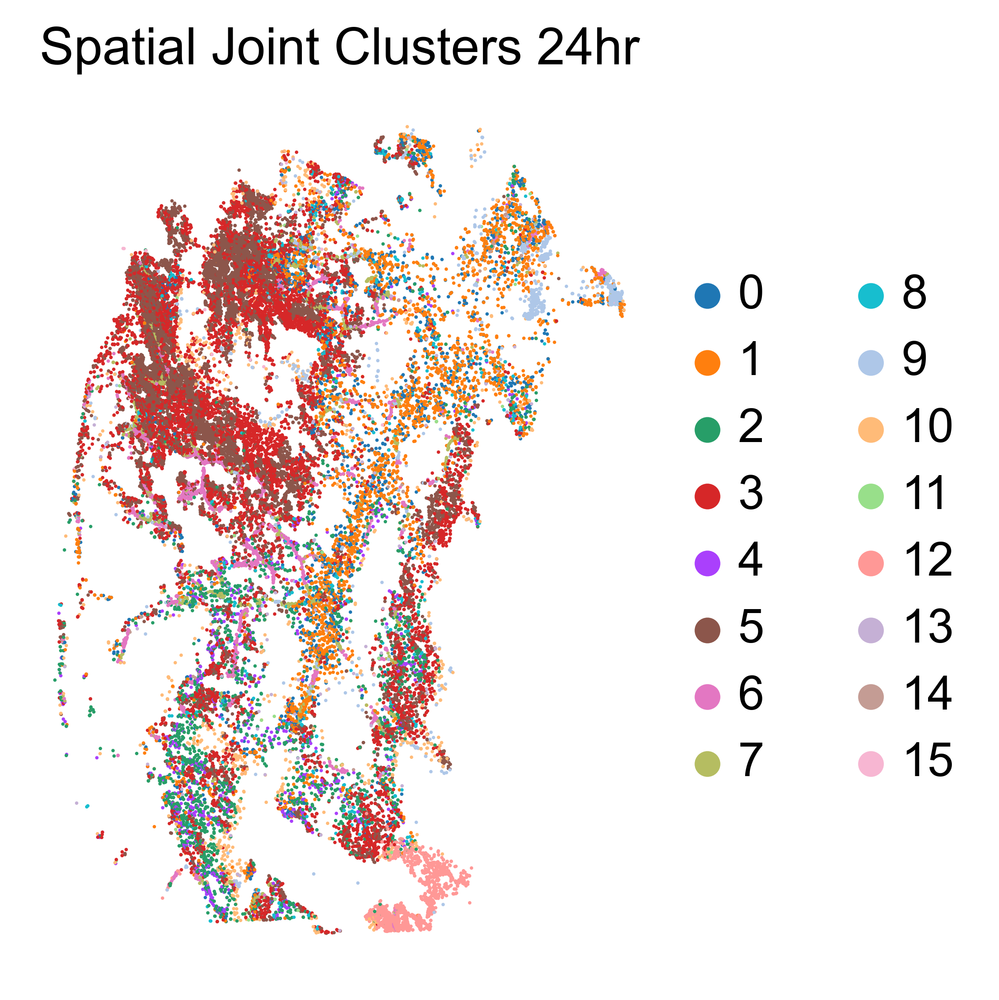

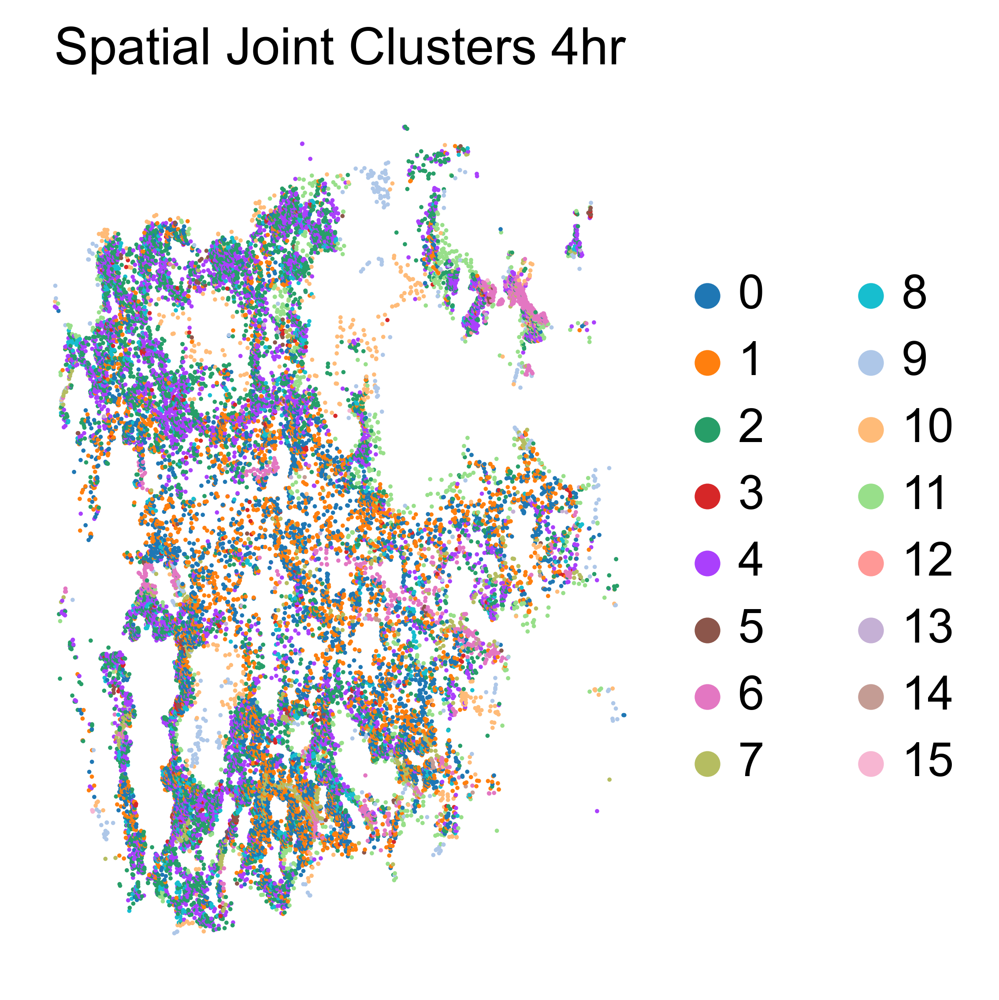

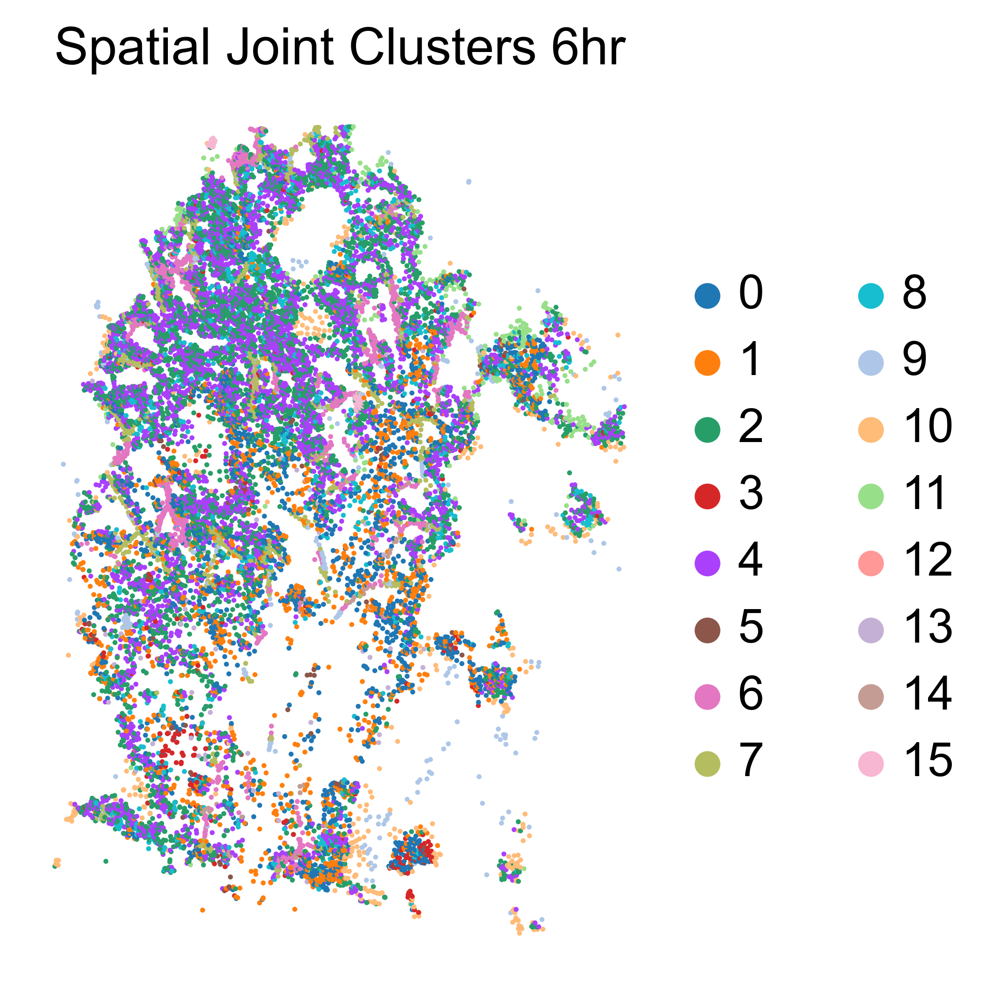

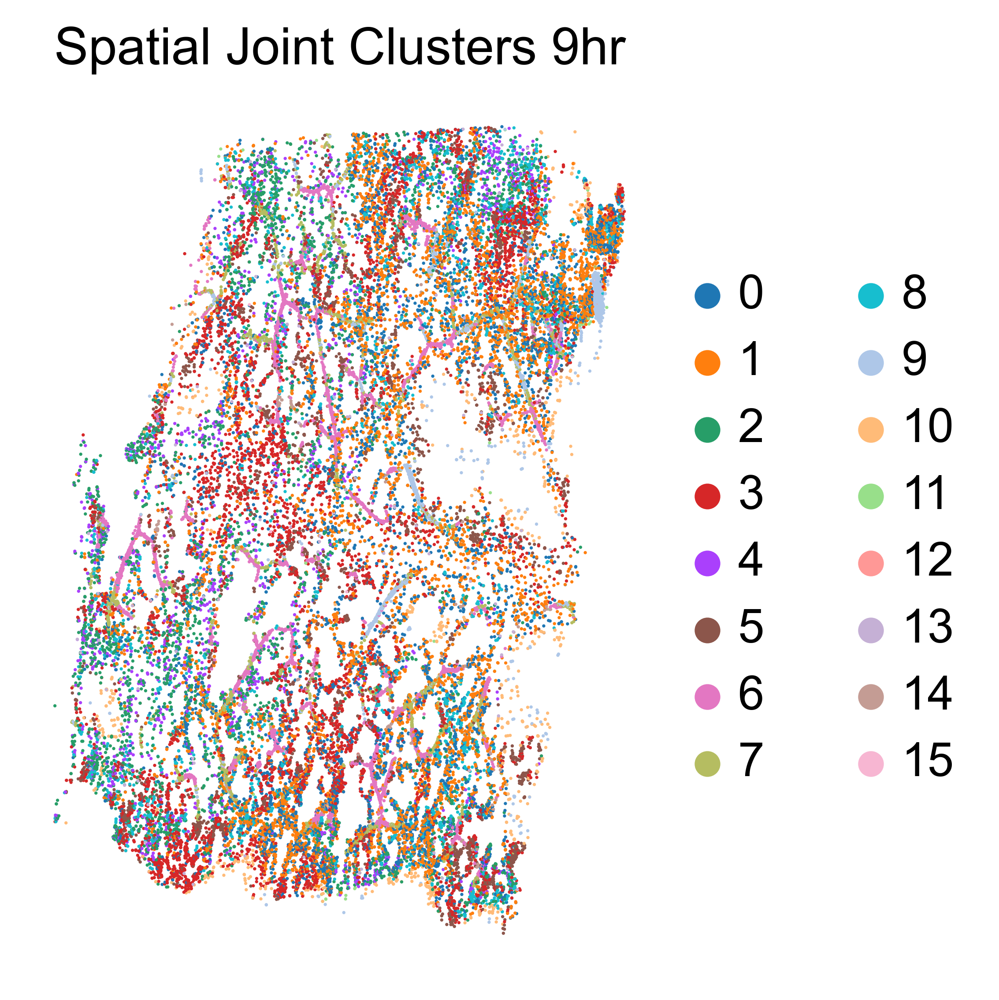

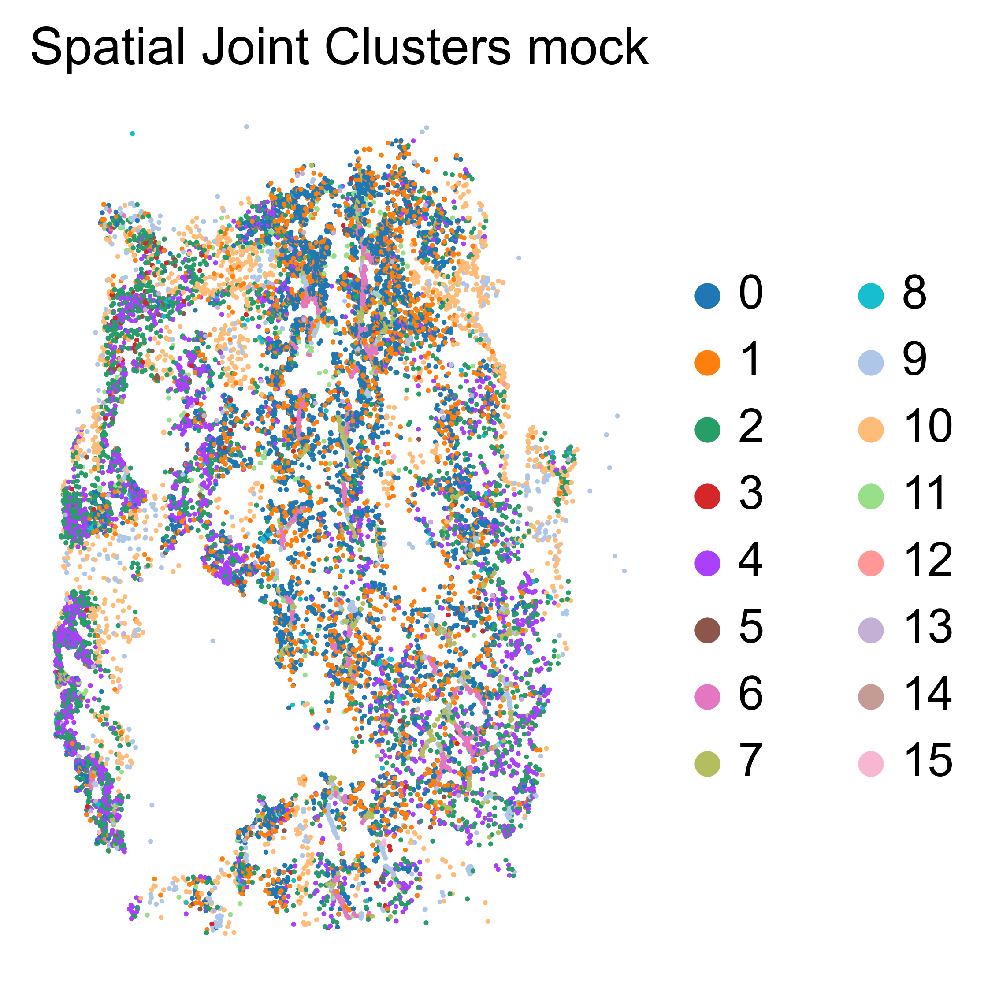

In [9]:
for i in range(len(unique_batches)):
    batch = unique_batches[i]
    adata = ad_sp[ad_sp.obs.batch == batch]
    adata.obsm['X_spatial'] = adata.obs[['x', 'y']].values
    fig = sc.pl.embedding(adata, basis='spatial', color=['seurat_clusters'], vmax=0.1, frameon=False, title=f'Spatial Joint Clusters {batch}', return_fig=True)
    fig.tight_layout()
    fig.savefig(os.path.join(figure_output_folder, '5f', f'Spatial Joint Clusters {batch}.pdf'))

### Figure 5e

In [11]:
try:
    os.mkdir(os.path.join(figure_output_folder, '5e'))
except:
    print('Folder already exists')

/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: Us

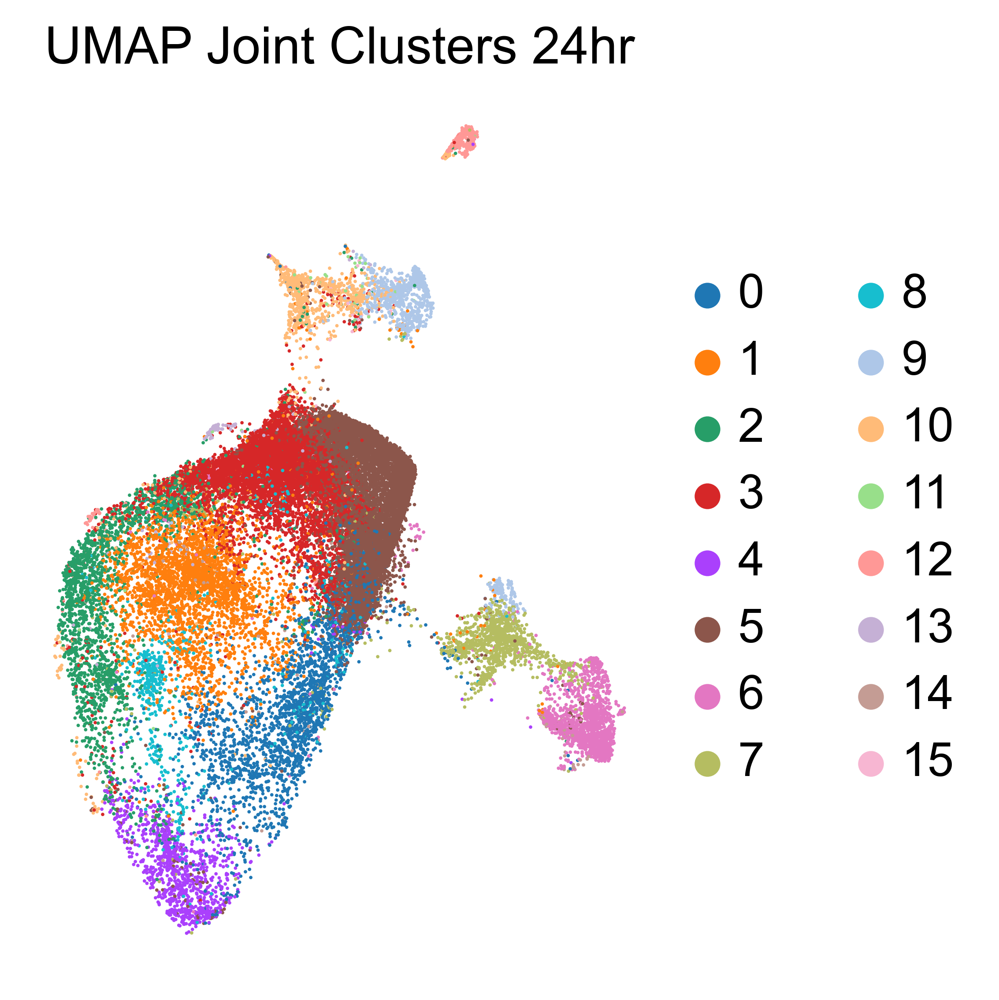

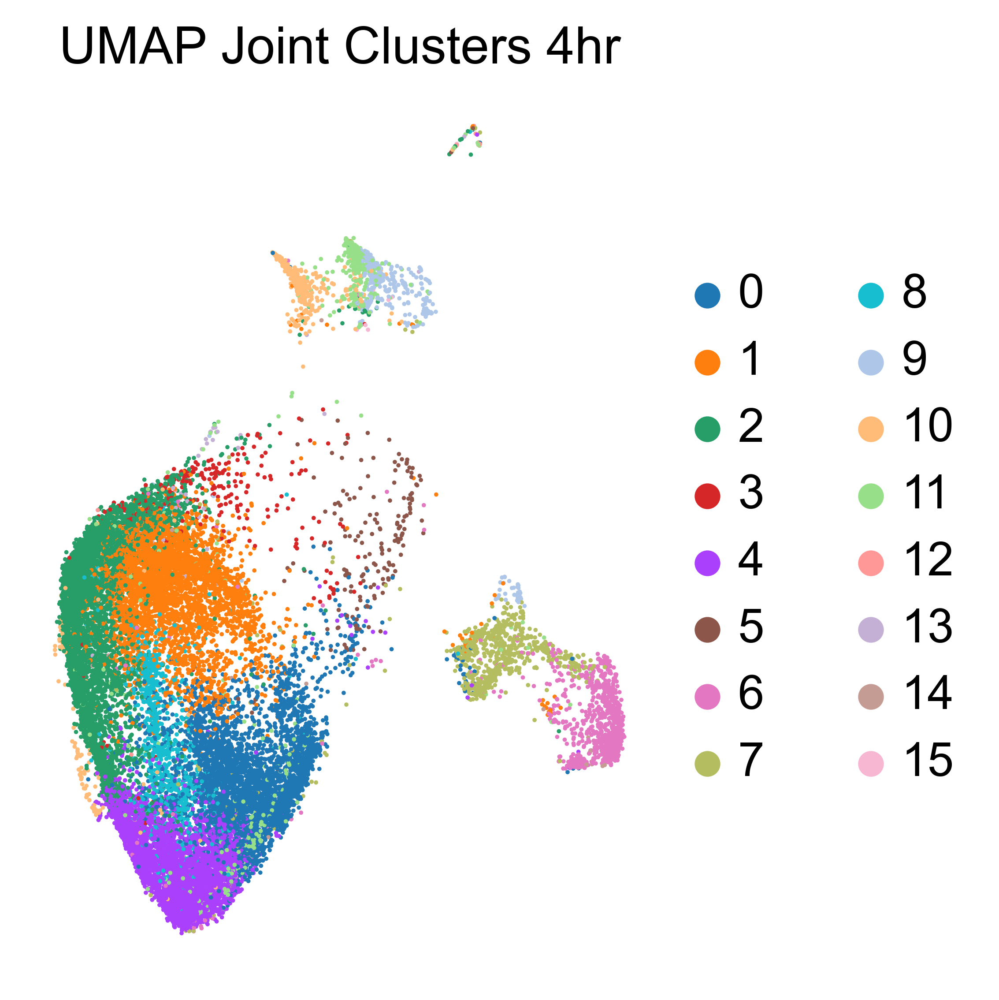

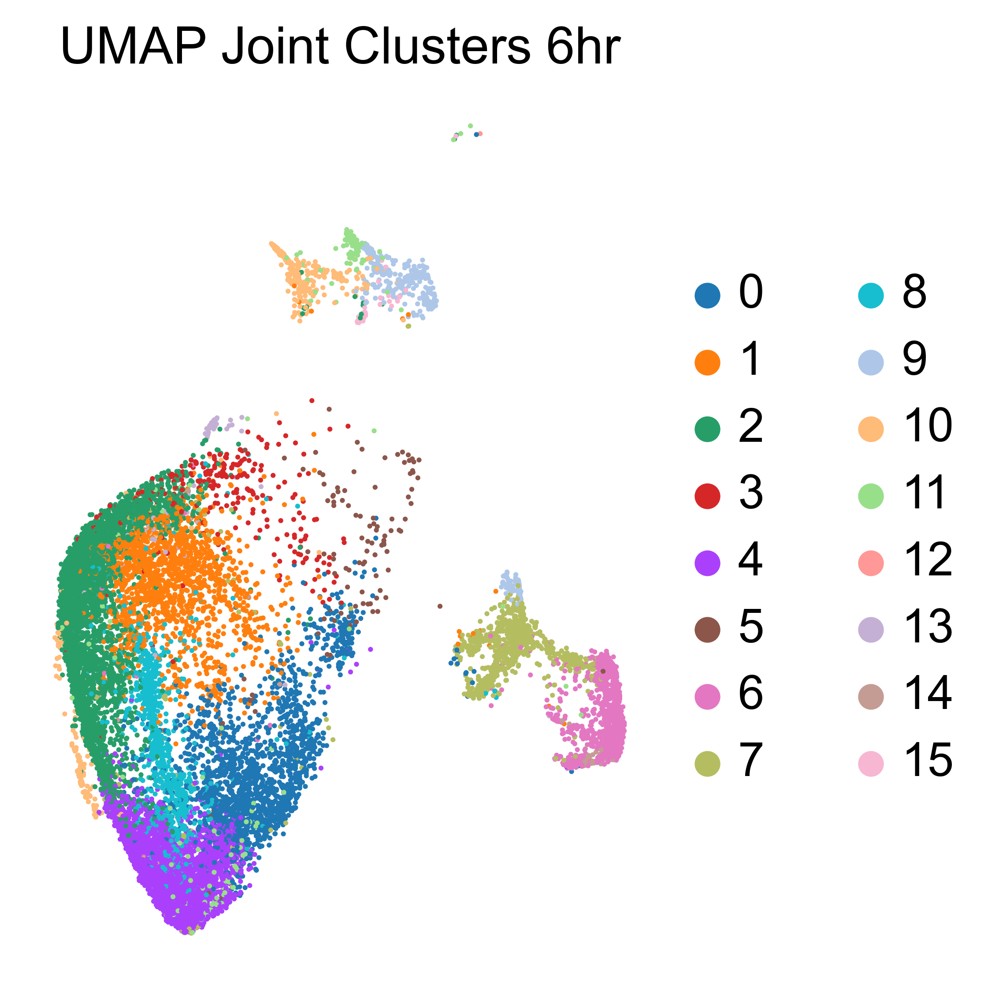

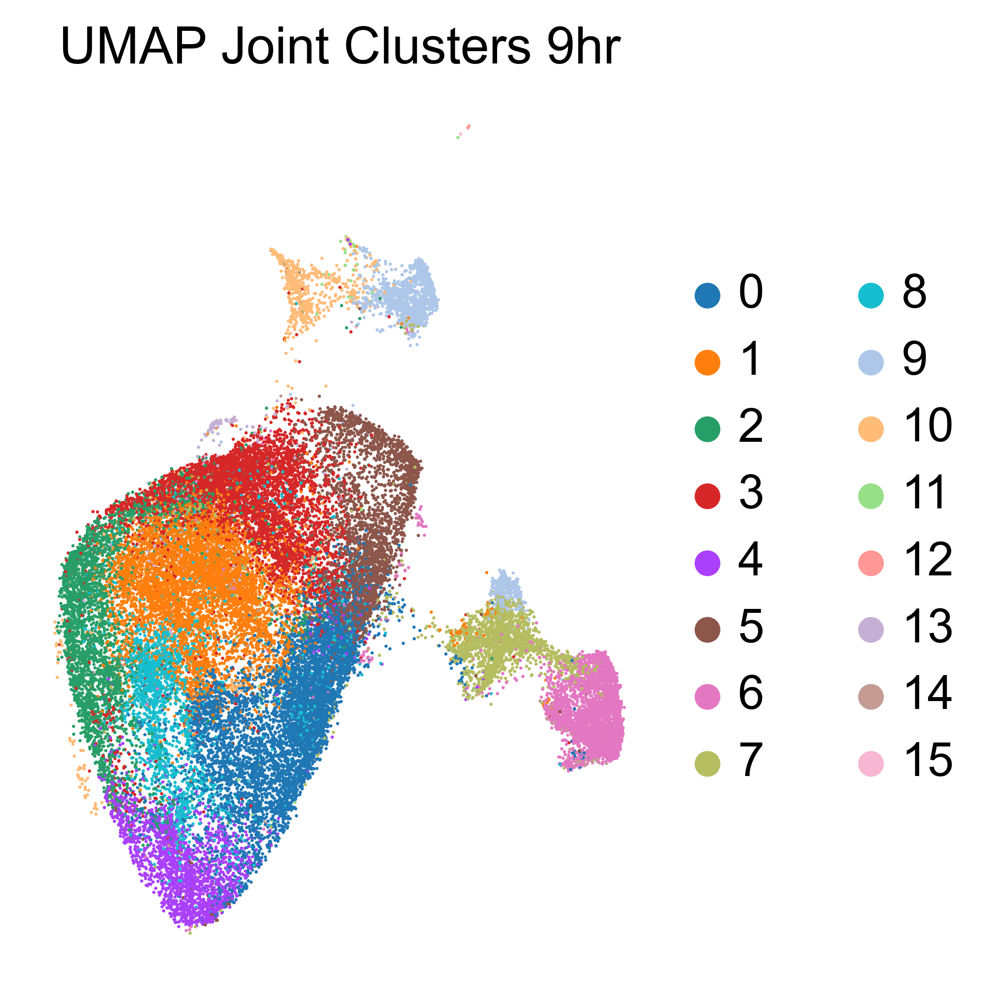

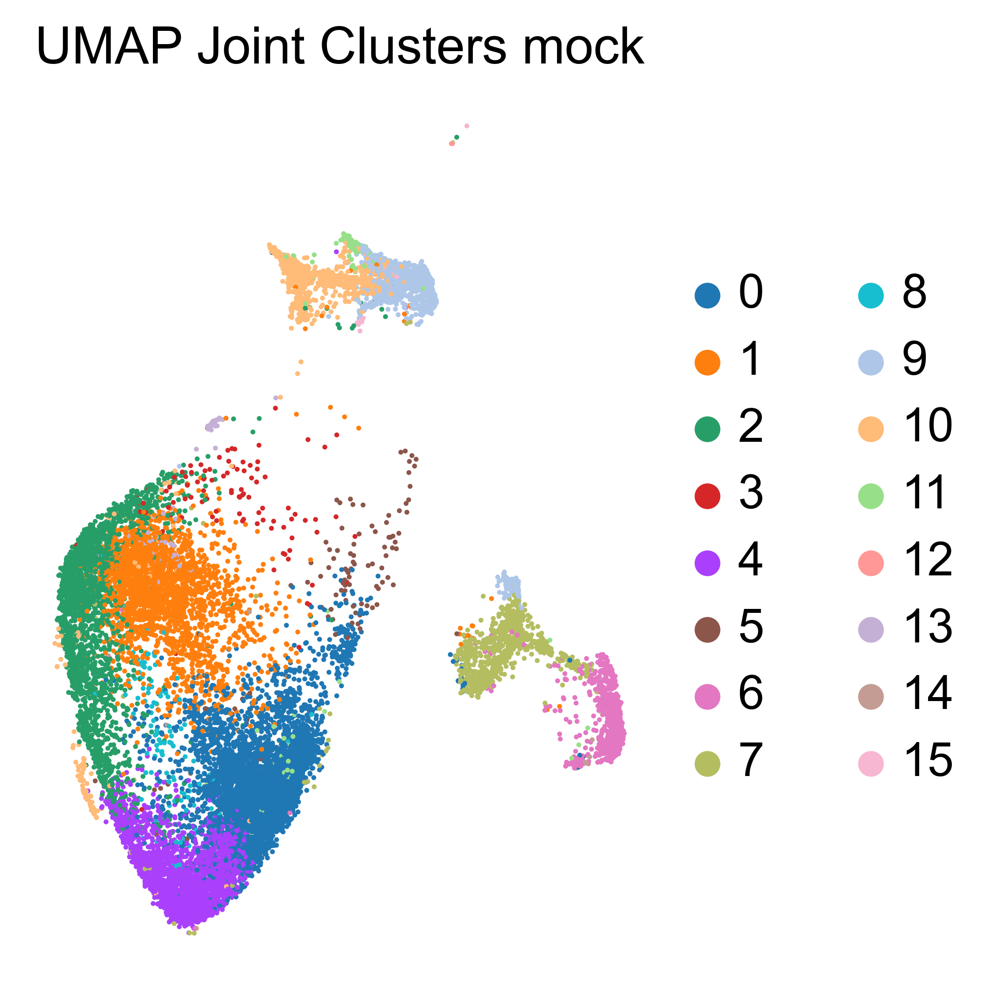

In [12]:
for i in range(len(unique_batches)):
    batch = unique_batches[i]
    adata = ad_sp[ad_sp.obs.batch == batch]
    adata.obsm['X_spatial'] = adata.obs[['x', 'y']].values
    fig = sc.pl.embedding(adata, basis='umap', color=['seurat_clusters'], vmax=0.1, frameon=False, title=f'UMAP Joint Clusters {batch}', return_fig=True)
    fig.tight_layout()
    fig.savefig(os.path.join(figure_output_folder, '5e', f'UMAP Joint Clusters {batch}.pdf'))

### Related Figure

In [7]:
try:
    os.mkdir(os.path.join(figure_output_folder, 'combined_joint_umap'))
except:
    print('Folder already exists')

/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


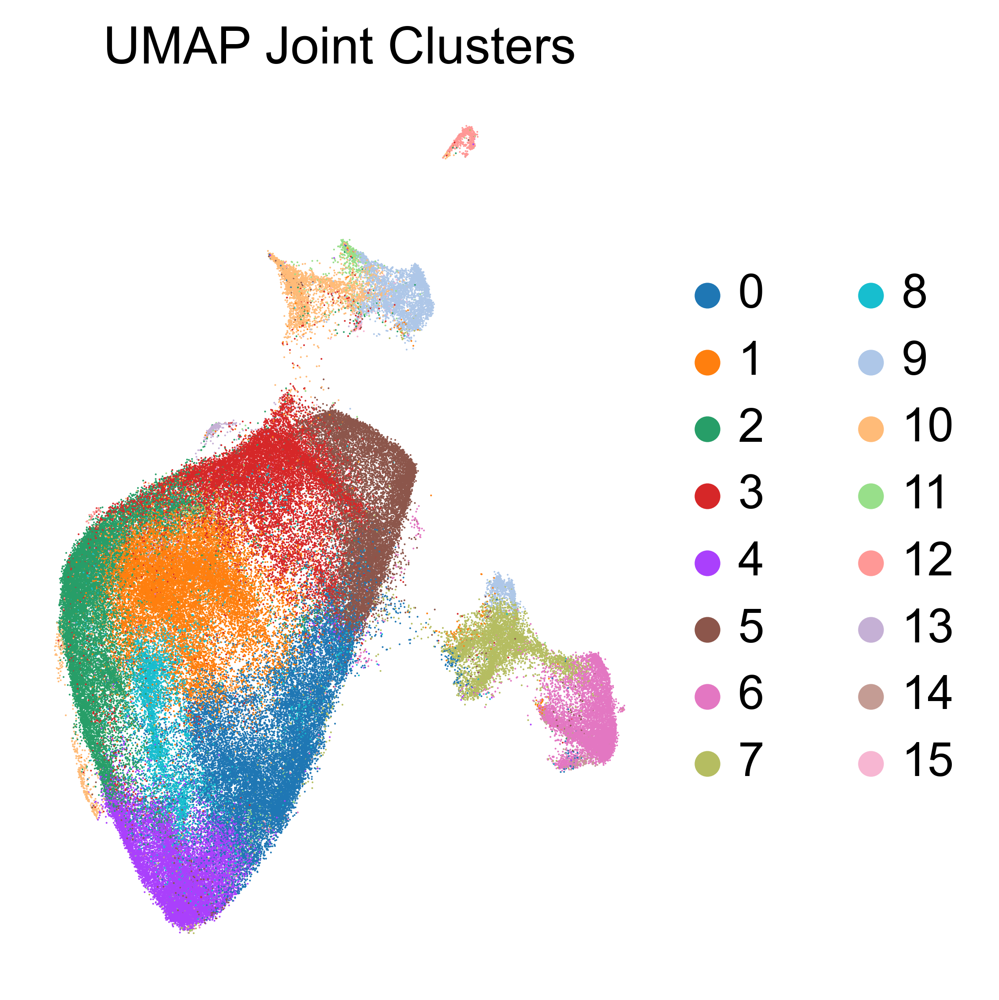

In [14]:

fig = sc.pl.embedding(ad_sp, basis='umap', color=['seurat_clusters'], vmax=0.1, frameon=False, title=f'UMAP Joint Clusters', return_fig=True)
fig.tight_layout()
fig.savefig(os.path.join(figure_output_folder, 'combined_joint_umap', f'UMAP Joint Clusters.pdf'))

In [8]:
celltypes = {'7': 'Vasculature', '9': 'Mesophyll', '6': 'Vasculature', '10': 'Epidermis'}

In [9]:
celltypes_all = []
for i in ad_sp.obs['seurat_clusters']:
    if i in list(celltypes.keys()):
        celltypes_all.append(celltypes.get(i))
    else:
        celltypes_all.append('Mesophyll')

In [10]:
ad_sp.obs['celltype'] = celltypes_all

In [11]:
ad_sp.var

""
index
LHY
AT1G01230
ERF023
ACS2
NAC004
...
AT5G66900
MAPKKK19
EPS1


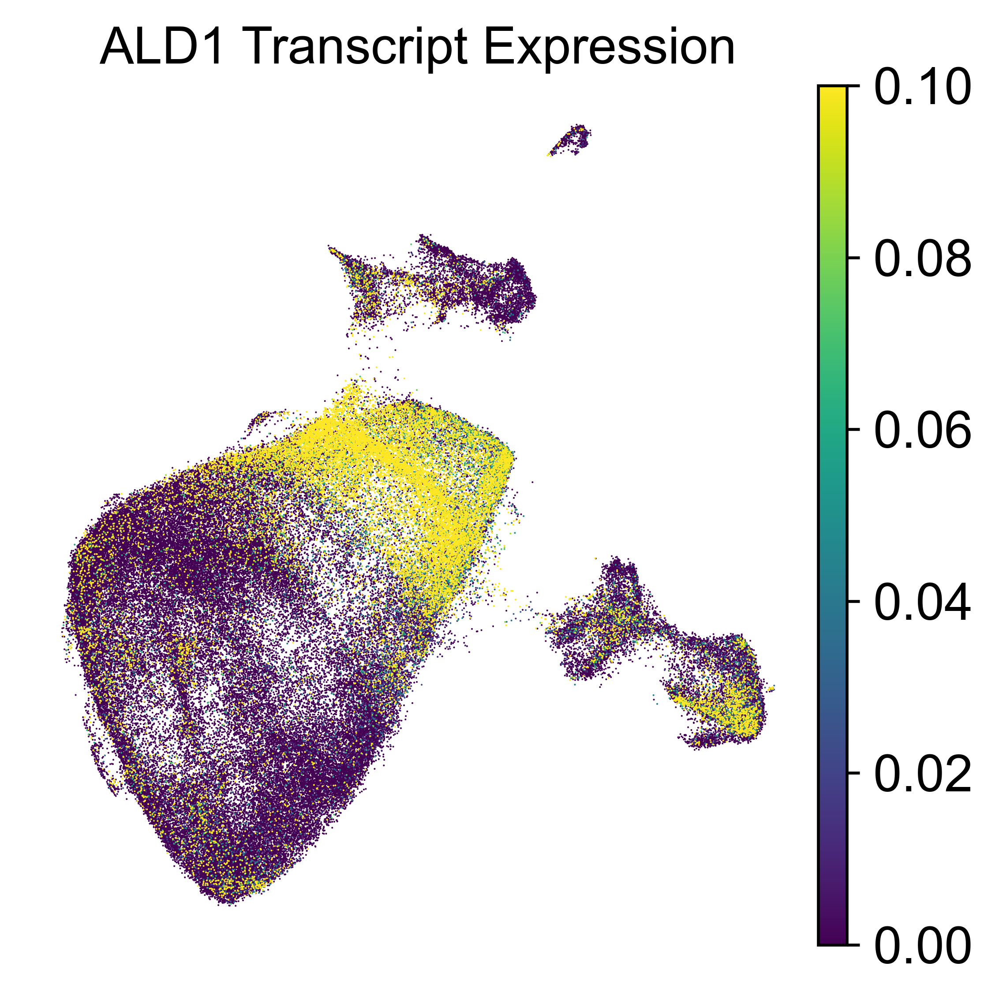

In [14]:
fig = sc.pl.embedding(ad_sp, basis='umap', color=['ALD1'], vmax=0.1, frameon=False, title=f'ALD1 Transcript Expression', return_fig=True)
fig.tight_layout()

/home/amonell/mambaforge/envs/merscope_01/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


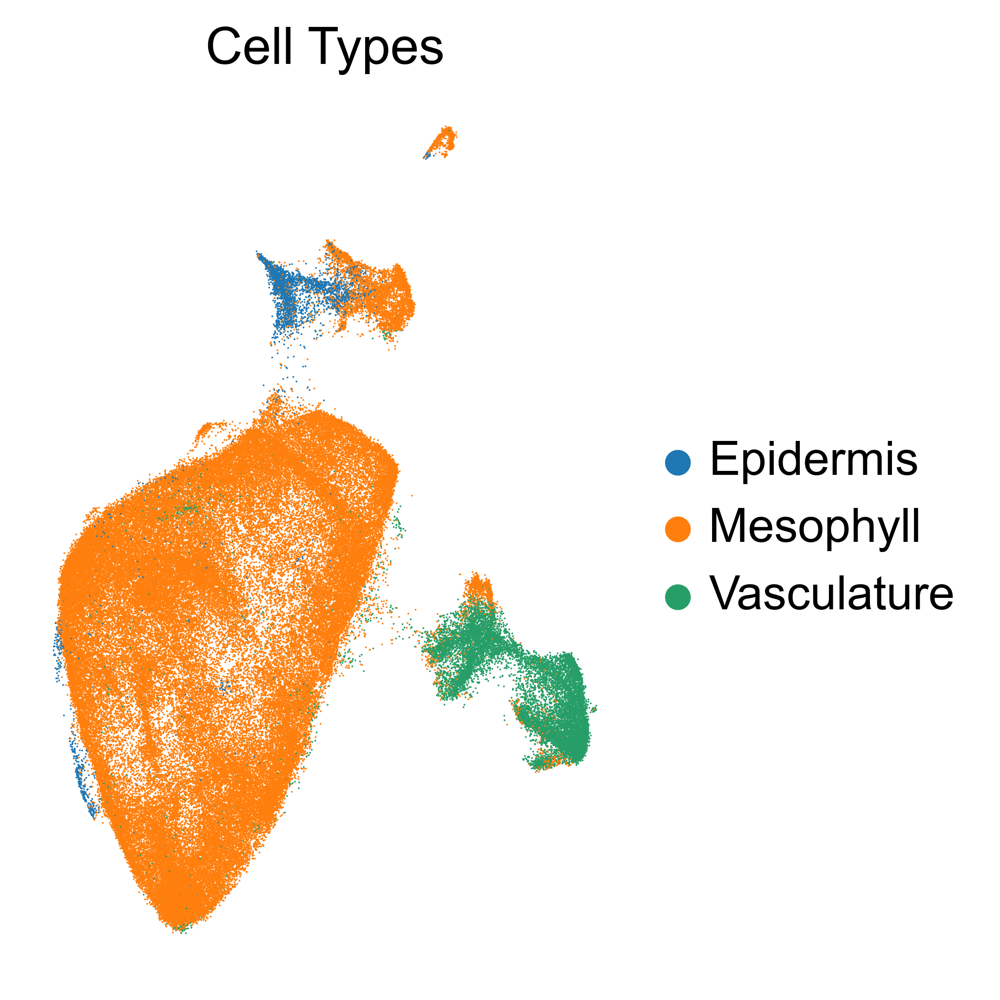

In [15]:
fig = sc.pl.embedding(ad_sp, basis='umap', color=['celltype'], vmax=0.1, frameon=False, title=f'Cell Types', return_fig=True)
fig.tight_layout()
#fig.savefig(os.path.join(figure_output_folder, 'combined_joint_umap', f'UMAP Joint Clusters.pdf'))

In [ ]:
for i in range(len(unique_batches)):
    batch = unique_batches[i]
    adata = ad_sp[ad_sp.obs.batch == batch]
    adata.obsm['X_spatial'] = adata.obs[['x', 'y']].values
    fig = sc.pl.embedding(adata, basis='umap', color=['seurat_clusters'], vmax=0.1, frameon=False, title=f'UMAP Joint Clusters {batch}', return_fig=True)
    fig.tight_layout()
    fig.savefig(os.path.join(figure_output_folder, '5e', f'UMAP Joint Clusters {batch}.pdf'))